# Intro to HoloViews

HoloViews is another data analysis library that aims to seamlessly combine your large data sets with graphic visualization tools - namely, bokeh.


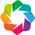

In [1]:
import pandas as pd
import numpy as np
import holoviews as hv
hv.extension('bokeh')

In [2]:
station_info = pd.read_csv('station_info.csv')
station_info.head()

,name,lat,lon,opened,services,service_names,ridership
0,First Avenue,40.730953,-73.981628,1924,1,['L'],7.702110
1,Second Avenue,40.723402,-73.989938,1936,1,['F'],5.847710
2,Third Avenue,40.732849,-73.986122,1924,1,['L'],2.386533
3,Fifth Avenue,40.753821,-73.981963,1920,6,"['7', 'E', 'M', 'N', 'R', 'W']",16.220605
4,Sixth Avenue,40.737335,-73.996786,1924,1,['L'],16.121318


In [3]:
scatter = hv.Scatter(station_info, kdims=['services'], vdims=['ridership'])
scatter

/home/mybuntu/anaconda3/envs/pyviz/lib/python3.6/site-packages/bokeh/core/json_encoder.py:73: FutureWarning: pandas.tslib is deprecated and will be removed in a future version.
You can access Timestamp as pandas.Timestamp
  if pd and isinstance(obj, pd.tslib.Timestamp):


:Scatter   [services]   (ridership)

In [4]:
hist = hv.Histogram(
    np.histogram(station_info['opened'], bins=24), kdims=['opened']
)
hist

:Histogram   [opened]   (Frequency)

In [5]:
layout = scatter + hist
layout

:Layout
   .Scatter.I   :Scatter   [services]   (ridership)
   .Histogram.I :Histogram   [opened]   (Frequency)

In [6]:
taxi_npz = np.load('hourly_taxi_data.npz')
taxi_dropoffs = {hour: arr for hour, arr in taxi_npz.items()}
np.info(taxi_dropoffs['0'])

class:  ndarray
shape:  (256, 256)
strides:  (1024, 4)
itemsize:  4
aligned:  True
contiguous:  True
fortran:  False
data pointer: 0x2a98860
byteorder:  little
byteswap:  False
type: float32


In [7]:
bounds = (-74.05, 40.70, -73.90, 40.80)
image = hv.Image(taxi_dropoffs['0'], bounds=bounds, kdims=['lon', 'lat'])

points = hv.Points(station_info, kdims=['lon', 'lat'])
image + image * points

:Layout
   .Image.I   :Image   [lon,lat]   (z)
   .Overlay.I :Overlay
      .Image.I  :Image   [lon,lat]   (z)
      .Points.I :Points   [lon,lat]   (name,opened,services,service_names,ridership)

In [11]:
images = {int(hour): hv.Image(arr, bounds=bounds, kdims=['lon', 'lat'])
         for hour, arr in taxi_dropoffs.items()}
holomap = hv.HoloMap(images, kdims=['Hour'])
holomap

:HoloMap   [Hour]
   :Image   [lon,lat]   (z)

In [12]:
holomap.select(Hour={3, 6, 9}).layout()

:NdLayout   [Hour]
   :Image   [lon,lat]   (z)

In [14]:
%%opts Image [xrotation=90] Points (color='deepskyblue' marker='v' size=6)
hotspot = points.select(lon=(-73.99, -73.96), lat=(40.75, 40.765))
composition = holomap * hotspot
composition

:HoloMap   [Hour]
   :Overlay
      .Image.I  :Image   [lon,lat]   (z)
      .Points.I :Points   [lon,lat]   (name,opened,services,service_names,ridership)

In [15]:
composition.select(Hour=7)

:Overlay
   .Image.I  :Image   [lon,lat]   (z)
   .Points.I :Points   [lon,lat]   (name,opened,services,service_names,ridership)

In [16]:
hotspot.data

,name,lat,lon,opened,services,service_names,ridership
3,Fifth Avenue,40.753821,-73.981963,1920,6,"['7', 'E', 'M', 'N', 'R', 'W']",16.220605
5,Seventh Avenue,40.762862,-73.981637,1919,7,"['B', 'D', 'E', 'N', 'Q', 'R', 'W']",12.013107
14,42nd Street,40.757308,-73.989735,1932,7,"['A', 'B', 'C', 'D', 'E', 'F', 'M']",66.359208
15,49th Street,40.759901,-73.984139,1919,4,"['N', 'Q', 'R', 'W']",8.029988
16,51st Street,40.757107,-73.971920,1918,2,"['4', '6']",20.479923
17,57th Street,40.764664,-73.980658,1968,1,['F'],4.720245
18,59th Street,40.762526,-73.967967,1918,3,"['4', '5', '6']",25.566655
46,Grand Central–42nd Street,40.751776,-73.976848,1904,5,"['4', '5', '6', '7', 'S']",46.737564
49,Lexington Avenue,40.762660,-73.967258,1920,7,"['E', 'F', 'M', 'N', 'Q', 'R', 'W']",21.407792
55,Times Square–42nd Street,40.754672,-73.986754,1917,7,"['1', '2', '3', 'N', 'Q', 'R', 'W']",66.359208
